# Infering the Parameters

We have our data and our simulation (see data_explore and model_simulation), now we need to estimate the parameters. In this notebook, we will assume that all parameters are the same between individuals and that variation between individuals is simply due to some error on each observation. This method of parameter estimation is Naive Pooled Inference.

In [3]:
!pip install ipynb
!pip install ./pints-master

Processing ./pints-master
  Created wheel for pints: filename=pints-0.2.2-cp37-none-any.whl size=229011 sha256=6531ed839cd9c4cc4b3576b8f2e1cd15cb961e83799e3744b764e75487dc35a8
  Stored in directory: /home/rumneyr/.cache/pip/wheels/23/f1/0b/7f6d8d6d6358237dd5757166c40f8f414a896a8f6f3b677add
Successfully built pints
  Found existing installation: pints 0.2.2
    Uninstalling pints-0.2.2:
      Successfully uninstalled pints-0.2.2


In [4]:
import numpy as np
import math
import matplotlib.pyplot as plt
import scipy
from scipy import optimize, integrate
import pints
import pints.plot
import pandas
import plotly.express as px
import plotly.graph_objects as go

## Pharmacokenetics - Linear Model

Let's begin with the Linear Pharmacokenetic model. We will first see whether we can fit the model to simulated data before trying to fit to the real data.

### Simulated Data

In [2]:
from ipynb.fs.full.model_simulation import PK_iv_result # import the required model

# Options
# (only num_comp really affects the model in the simulated case)
drug = 'Simulated Drug'
dose = [1, 2, 5]
num_comp = 2

# Actual Parameters
# (This is only to produce the simulated data. These are 'unknown' when doing the inference)
Vol_C = 1
Cl = 2.5
Vol_perif = 0.5
Q_perif = 2.3

actual_parameters = [Vol_C, Cl, Vol_perif, Q_perif]
np.save('simulated_parameters_actual_multidose', np.array(actual_parameters))

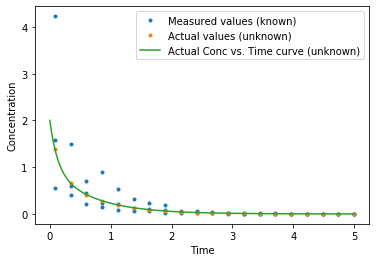

In [3]:
# Create the Data
time_span = 5
num_obs = 20

data_times = np.concatenate((np.array([0]), np.linspace(0.083, time_span, num_obs)))
# data_times = [0, 0.083, 0.333,  2.5, 4.666, 4.833, 5] 
# Uncomment the above line if you want the simulated data to mimic the real data

noise = np.random.normal(0, 0.2, (len(dose), len(data_times)))
values_no_noise = []
for d in dose:
    values_no_noise.append(PK_iv_result(d, num_comp, actual_parameters, data_times)[:,0])
values_no_noise = np.asarray(values_no_noise)
# values_noisey = np.exp(np.log(values_no_noise) + noise)
values_noisey = values_no_noise + noise*values_no_noise

time_column = np.array([])
obs_column = np.array([])
dose_column = []
for i,d in enumerate(dose):
    time_column = np.concatenate((time_column, data_times[1:]))
    obs_column = np.concatenate((obs_column, values_noisey[i, 1:]))
    dose_column = dose_column + [dose[i]]*len(data_times[1:])
df = pandas.DataFrame({'TIME' : time_column, 'OBS' : obs_column, 'DOSE' : dose_column})

more_times = np.linspace(0,time_span,1000)
more_values = PK_iv_result(dose[1], num_comp, actual_parameters, more_times)[:,0]

# Visualise the data
plt.plot(df['TIME'], df['OBS'], '.', label='Measured values (known)')
plt.plot(data_times[1:], values_no_noise[1, 1:], '.', label='Actual values (unknown)')
plt.plot(more_times, more_values, label='Actual Conc vs. Time curve (unknown)')
plt.xlabel('Time')
plt.ylabel('Concentration')
plt.legend()
plt.show()

In [4]:
# df.to_csv(r'sythesised_data_real_timepoints.csv', index = False)
# df['OBS'] = df['OBS'].abs()
# df['log_value'] = np.log(df['OBS'])
print(df)

        TIME       OBS  DOSE
0   0.083000  0.549264     1
1   0.341789  0.401724     1
2   0.600579  0.222742     1
3   0.859368  0.155566     1
4   1.118158  0.093538     1
5   1.376947  0.067641     1
6   1.635737  0.054666     1
7   1.894526  0.030114     1
8   2.153316  0.019384     1
9   2.412105  0.012774     1
10  2.670895  0.011351     1
11  2.929684  0.008673     1
12  3.188474  0.004697     1
13  3.447263  0.004156     1
14  3.706053  0.002562     1
15  3.964842  0.001560     1
16  4.223632  0.001145     1
17  4.482421  0.000711     1
18  4.741211  0.000401     1
19  5.000000  0.000256     1
20  0.083000  1.583589     2
21  0.341789  0.588429     2
22  0.600579  0.447540     2
23  0.859368  0.226994     2
24  1.118158  0.214641     2
25  1.376947  0.125536     2
26  1.635737  0.095703     2
27  1.894526  0.079420     2
28  2.153316  0.043191     2
29  2.412105  0.033331     2
30  2.670895  0.028789     2
31  2.929684  0.015266     2
32  3.188474  0.007424     2
33  3.447263  

In [5]:
# Create the model in PINTS 

class PintsLinCompIV(pints.ForwardModel):
    def n_parameters(self):
        return num_comp*2
    def n_outputs(self):
        return len(dose)
    def simulate(self, parameter, times):
        if times[0] == 0:
            result = []
            for i,d in enumerate(dose):
                result.append(PK_iv_result(d, num_comp, parameter, times)[:,0])
            return np.asarray(result).T
        elif times[0] > 0:  
            # If the times do not start at 0 then odeint will begin simulation at the first timepoint.
            # However our model assumes dosing happens at t=0 so we will need to add 0 to the times array and
            # then ignore the result at t=0.
            times = np.concatenate((np.array([0]), times))
            result = []
            for i,d in enumerate(dose):
                result.append(PK_iv_result(d, num_comp, parameter, times)[1:,0])
            return np.asarray(result).T
        
class RatioError(pints.ProblemErrorMeasure):
    """
    Calculates a sum-of-squares error: ``f = sum( (log10(x[i]) -log10( y[i])**2 )``
    Extends :class:`ErrorMeasure`.
    Parameters
    ----------
    problem
        A :class:`pints.SingleOutputProblem` or
        :class:`pints.MultiOutputProblem`.
    """

    def __init__(self, problem, weights=None):
        super(RatioError, self).__init__(problem)

        if weights is None:
            weights = [1] * self._n_outputs
        elif self._n_outputs != len(weights):
            raise ValueError(
                'Number of weights must match number of problem outputs.')
        # Check weights
        self._weights = np.asarray([float(w) for w in weights])

    def __call__(self, x):
        return np.sum((np.sum((((self._problem.evaluate(x) - self._values) / self._values) ** 2),
                              axis=0) * self._weights),
                      axis=0)

In [6]:
# Before starting the optimisation we should estimate the parameter Vol_C. We can do this by drawing a line 
# through the first 2 point and seeing where it crosses the y-axis
point_1 = (df['TIME'][0], df['OBS'][0])
point_2 = (df['TIME'][1], df['OBS'][1])
y_0 = point_1[1] - (point_1[1] - point_2[1])/(point_1[0] - point_2[0]) * point_1[0]
Vol_C_approx = y_0/dose[0]
print(point_1, point_2, y_0, Vol_C_approx)

(0.083, 0.5492642235232729) (0.34178947368421053, 0.4017244547118209) 0.5965837710961139 0.5965837710961139


In [7]:
# Optimise the model with respect to the data
time = df['TIME'][0:int(len(df)/len(dose))].to_numpy()
obs = np.reshape(df['OBS'].to_numpy(), (len(dose), int(len(df)/len(dose)))).T
problem = pints.MultiOutputProblem(PintsLinCompIV(), time, obs)
error_measure = RatioError(problem)
lower_bound = [0.01, 0.01, 0.01, 0.01]
upper_bound = [100, 100, 100, 100]
optimisation = pints.OptimisationController(error_measure, [Vol_C_approx, 1, 1, 1], method=pints.XNES, boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
# optimisation.set_log_to_screen(False)
parameters1, error1 = optimisation.run()

optimisation = pints.OptimisationController(error_measure, parameters1, method=pints.PSO, boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
# optimisation.set_log_to_screen(False)
parameters, error = optimisation.run()

# Show results
print('\t\t Run 1 \t\t\t\t\t Run2 \t\t\t\t\t Real')
print('Result: \t'+str(parameters1)+'\t'+str(parameters)+'\t'+str([Vol_C, Cl, Vol_perif, Q_perif]))
print('Error: \t\t'+str(error1)+'\t\t\t'+str(error)+'\t\t\t'+str(error_measure([Vol_C, Cl, Vol_perif, Q_perif])))
# plt.figure()
# plt.plot(df['TIME'],  df['OBS'], '.', label='Observed values')
# plt.plot(more_times, more_values, label='Actual curve')
# plt.plot(more_times, PK_iv_result(dose, num_comp, parameters, more_times)[:,0], '--', lw=2, label='Predicted Curve')
# plt.legend()

Minimising error measure
Using Exponential Natural Evolution Strategy (xNES)
Running in sequential mode.
Population size: 8
Iter. Eval. Best      Time m:s
0     8      36.30992   0:00.2
1     16     36.30992   0:00.2
2     24     36.30992   0:00.3
3     32     33.31065   0:00.5
20    168    33.31065   0:02.3
40    328    33.31065   0:03.8
60    488    33.26151   0:05.2
80    648    31.20802   0:08.1
100   808    29.54187   0:12.2
120   968    28.00365   0:15.7
140   1128   25.78621   0:19.5
160   1288   23.35972   0:23.5
180   1448   22.27607   0:27.5
200   1608   21.48533   0:31.8
220   1768   20.7053    0:35.8
240   1928   20.21547   0:39.5
260   2088   19.41027   0:43.6
280   2248   18.72422   0:47.2
300   2408   18.22003   0:50.2
320   2568   17.82469   0:53.2
340   2728   17.34      0:56.1
360   2888   16.94291   0:58.9
380   3048   16.32198   1:02.1
400   3208   15.26468   1:05.1
420   3368   14.28705   1:08.1
440   3528   13.1229    1:11.6
460   3688   12.22407   1:14.8
480   38

In [8]:
# Lets Visualise using Plotly
import seaborn
import matplotlib.colors as clrs
from colorsys import rgb_to_hls

y_label = drug + " Concentration"
x_label = "Time"
df_graph = df.astype({'DOSE': 'str'})

fig = px.scatter(
    df_graph,
    title=drug + " Concentration Mean",
    x="TIME",
    y="OBS",
    color = "DOSE",
    width=800, 
    height=500
)

fig.update_xaxes(title_text=x_label)
fig.update_yaxes(title_text=y_label)
# fig.update_traces(mode='markers+lines')
# fig['data'][0]['showlegend']=True
# fig['data'][0]['name']='Observed Values'
for i,d in enumerate(dose):
    hex_color = px.colors.qualitative.Plotly[i]
    fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(parameters, more_times)[:,i],
                        mode='lines',
                        name='Prediction',
                        legendgroup = d,
                        line={'dash': 'solid', 'color': hex_color}))
    
    rgb_color = clrs.ColorConverter.to_rgb(hex_color)
    lightness = min(1, rgb_to_hls(*rgb_color)[1] * 0.5)
    altered_color = clrs.to_hex(seaborn.set_hls_values(hex_color, l=lightness))
    
    fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(actual_parameters, more_times)[:,i],
                        mode='lines',
                        name='Actual',
                        legendgroup = d,
                        line={'dash': 'dash', 'color': altered_color}))

# fig.add_trace(go.Scatter(x=[0, point_2[0]], y=[y_0, point_2[1]],
#                     mode='lines',
#                     name='Y-axis intercept prediction'))

fig.update_layout(
    updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(
                    args=[{"yaxis.type": "linear"}],
                    label="Linear y-scale",
                    method="relayout"
                ),
                dict(
                    args=[{"yaxis.type": "log"}],
                    label="Log y-scale",
                    method="relayout"
                )
            ]),
            pad={"r": 0, "t": -10},
            showactive=True,
            x=1.0,
            xanchor="right",
            y=1.15,
            yanchor="top"
        ),
    ]
)
fig.show()

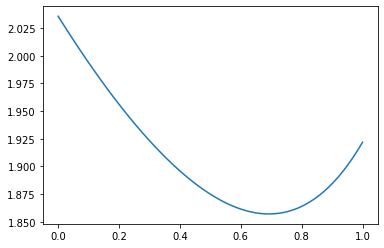

In [9]:
num_points = 100
P_0 = np.asarray([Vol_C, Cl, Vol_perif, Q_perif])
P_1 = parameters1
errors = []
xs = np.linspace(0, 1, num_points)

for x in xs:
    point = x*P_0+(1-x)*P_1
    errors.append(error_measure(point))
    
plt.plot(xs, errors)
plt.show()

This is a useful way of estimating the correct parameters and visualising how good the model and estimated parameters fit the data. However, it would also be useful to know how sure we are on these parameter values. To do this we use Bayesian inference and MCMC to sample the parameter space and give a distribution of probable parameter values.

In [10]:
class SingleMultiplicativeGaussianLogLikelihood(pints.ProblemLogLikelihood):
    r"""
    Fixed Eta
    
    Calculates the log-likelihood for a time-series model assuming a single
    heteroscedastic Gaussian error of the model predictions
    :math:`f(t, \theta )`.
    This likelihood introduces two new scalar parameters, both of which are constant across all dimensions of
    the model output: an exponential power :math:`\eta` and a scale
    :math:`\sigma`.
    A heteroscedascic Gaussian noise model assumes that the observable
    :math:`X` is Gaussian distributed around the model predictions
    :math:`f(t, \theta )` with a standard deviation that scales with
    :math:`f(t, \theta )`
    .. math::
        X(t) = f(t, \theta) + \sigma f(t, \theta)^\eta v(t)
    where :math:`v(t)` is a standard i.i.d. Gaussian random variable
    .. math::
        v(t) \sim \mathcal{N}(0, 1).
    This model leads to a log likelihood of the model parameters of
    .. math::
        \log{L(\theta, \eta , \sigma | X^{\text{obs}})} =
            -\frac{n_t}{2} \log{2 \pi}
            -\sum_{i=1}^{n_t}{\log{f(t_i, \theta)^\eta \sigma}}
            -\frac{1}{2}\sum_{i=1}^{n_t}\left(
                \frac{X^{\text{obs}}_{i} - f(t_i, \theta)}
                {f(t_i, \theta)^\eta \sigma}\right) ^2,
    where :math:`n_t` is the number of time points in the series, and
    :math:`X^{\text{obs}}_{i}` the measurement at time :math:`t_i`.
    For a system with :math:`n_o` outputs, this becomes
    .. math::
        \log{L(\theta, \eta , \sigma | X^{\text{obs}})} =
            -\frac{n_t n_o}{2} \log{2 \pi}
            -\sum ^{n_o}_{j=1}\sum_{i=1}^{n_t}{\log{f_j(t_i, \theta)^\eta
            \sigma}}
            -\frac{1}{2}\sum ^{n_o}_{j=1}\sum_{i=1}^{n_t}\left(
                \frac{X^{\text{obs}}_{ij} - f_j(t_i, \theta)}
                {f_j(t_i, \theta)^\eta \sigma}\right) ^2,
    where :math:`n_o` is the number of outputs of the model, and
    :math:`X^{\text{obs}}_{ij}` the measurement of output :math:`j` at
    time point :math:`t_i`.
    Extends :class:`ProblemLogLikelihood`.
    Parameters
    ----------
    ``problem``
        A :class:`SingleOutputProblem` or :class:`MultiOutputProblem`. For both
        single-output problems and multi-output problems, two parameters are added (:math:`\eta`,
        :math:`\sigma`).
    """

    def __init__(self, problem):
        super(SingleMultiplicativeGaussianLogLikelihood, self).__init__(problem)

        # Get number of times and number of outputs
        self._nt = len(self._times)
        no = problem.n_outputs()
        self._np = 1  # 1 parameters added

        # Add parameters to problem
        self._n_parameters = problem.n_parameters() + self._np

        # Pre-calculate the constant part of the likelihood
        self._logn = 0.5 * self._nt * no * np.log(2 * np.pi)

    def __call__(self, x):
        # Get noise parameters
        noise_parameters = x[-self._np:]
        eta = 1 # np.asarray(noise_parameters[0])
        sigma = np.asarray(noise_parameters[0])

        # Evaluate function (n_times, n_output)
        function_values = self._problem.evaluate(x[:-self._np])

        # Compute likelihood
        log_likelihood = \
            -self._logn - np.sum(
                np.sum(np.log(function_values**eta * sigma), axis=0)
                + 0.5 / sigma**2 * np.sum(
                    (self._values - function_values)**2
                    / function_values ** (2 * eta), axis=0))

        return log_likelihood

In [13]:
# log_likelihood = pints.GaussianLogLikelihood(problem)
log_likelihood = SingleMultiplicativeGaussianLogLikelihood(problem)
log_prior = pints.UniformLogPrior(lower_bound+[0], upper_bound+[1000])
log_posterior = pints.LogPosterior(log_likelihood, log_prior)

startpoints = [np.concatenate((np.asarray(parameters), np.asarray([0.1]))),np.concatenate((np.asarray(parameters)*0.5, np.asarray([0.05]))), np.concatenate((np.asarray(parameters)*1.5, np.asarray([0.2])))]
mcmc = pints.MCMCController(log_posterior, 3, startpoints, method=pints.HaarioBardenetACMC)
mcmc.set_max_iterations(15000)
# mcmc.set_log_to_screen(False)
samples = mcmc.run()

Using Haario-Bardenet adaptive covariance MCMC
Generating 3 chains.
Running in sequential mode.
Iter. Eval. Accept.   Accept.   Accept.   Time m:s
0     3      0         0         0          0:00.0
1     6      0         0         0          0:00.1
2     9      0         0.333     0.333      0:00.1
3     12     0         0.5       0.25       0:00.2
20    63     0.0476    0.238     0.143      0:00.5
40    123    0.0976    0.195122  0.146      0:00.9
60    183    0.0984    0.213     0.131      0:01.4
80    243    0.0741    0.198     0.111      0:01.9
100   303    0.0594    0.178     0.0891     0:02.5
120   363    0.0496    0.165     0.0826     0:03.0
140   423    0.0426    0.141844  0.0709     0:03.5
160   483    0.0435    0.124     0.0745     0:04.2
180   543    0.0387    0.121547  0.0718     0:04.8
Initial phase completed.
200   603    0.0348    0.109     0.0647     0:05.5
220   663    0.0769    0.145     0.095      0:06.1
240   723    0.112     0.17      0.141      0:06.7
260   783   

3100  9303   0.200258  0.208     0.202      2:29.3
3120  9363   0.2       0.208     0.202      2:31.2
3140  9423   0.201     0.207     0.202      2:32.7
3160  9483   0.202     0.207     0.201      2:34.3
3180  9543   0.202     0.207     0.201      2:36.0
3200  9603   0.203     0.207     0.201      2:37.6
3220  9663   0.204     0.207     0.203      2:39.1
3240  9723   0.204     0.207     0.204      2:40.7
3260  9783   0.203     0.207     0.204      2:42.8
3280  9843   0.203     0.206     0.204206   2:44.5
3300  9903   0.204     0.206     0.204      2:46.2
3320  9963   0.204     0.206     0.204      2:47.8
3340  10023  0.204     0.205     0.205      2:49.5
3360  10083  0.204     0.205     0.206      2:50.8
3380  10143  0.205     0.207     0.205      2:52.4
3400  10203  0.205     0.207     0.205      2:54.1
3420  10263  0.205     0.208     0.204      2:55.7
3440  10323  0.205     0.207     0.203      2:57.1
3460  10383  0.205143  0.207     0.203      2:59.1
3480  10443  0.205     0.207   

6320  18963  0.213     0.215     0.218      6:54.7
6340  19023  0.214     0.215     0.218      6:56.6
6360  19083  0.214     0.215     0.219      6:58.6
6380  19143  0.214073  0.215     0.218      7:00.7
6400  19203  0.214     0.214     0.218      7:02.3
6420  19263  0.214     0.214     0.218      7:04.0
6440  19323  0.214     0.214     0.217047   7:05.4
6460  19383  0.214     0.213744  0.216      7:06.9
6480  19443  0.214936  0.214     0.216      7:08.6
6500  19503  0.215     0.213     0.216      7:10.3
6520  19563  0.214     0.213     0.216      7:11.9
6540  19623  0.215     0.213423  0.216      7:13.7
6560  19683  0.215     0.214     0.216      7:15.2
6580  19743  0.215     0.213     0.216      7:16.8
6600  19803  0.215     0.213     0.216      7:18.5
6620  19863  0.215     0.213     0.215      7:20.0
6640  19923  0.215     0.214     0.215      7:21.6
6660  19983  0.215     0.214     0.215      7:23.3
6680  20043  0.216     0.214     0.214      7:24.9
6700  20103  0.215341  0.214   

9540  28623  0.22      0.222     0.221     11:25.1
9560  28683  0.22      0.222     0.220479  11:26.7
9580  28743  0.22      0.222     0.22      11:28.2
9600  28803  0.22      0.222     0.22      11:29.8
9620  28863  0.22      0.222     0.219     11:31.4
9640  28923  0.22      0.222     0.219     11:32.9
9660  28983  0.22      0.223     0.219     11:34.4
9680  29043  0.221     0.222     0.219     11:36.0
9700  29103  0.221     0.222     0.219     11:37.7
9720  29163  0.221     0.222     0.219     11:39.3
9740  29223  0.221     0.222     0.219     11:41.4
9760  29283  0.22      0.222     0.219     11:43.0
9780  29343  0.221     0.222     0.219     11:44.9
9800  29403  0.22      0.222     0.219     11:46.5
9820  29463  0.219835  0.222     0.219     11:48.0
9840  29523  0.22      0.221319  0.219     11:49.9
9860  29583  0.221     0.221     0.219     11:51.6
9880  29643  0.221     0.221     0.219     11:53.1
9900  29703  0.221     0.221     0.219     11:54.6
9920  29763  0.221     0.222   

12760 38283  0.222     0.224     0.223     15:21.7
12780 38343  0.222     0.224     0.222909  15:23.2
12800 38403  0.222     0.224     0.223     15:24.6
12820 38463  0.222     0.224     0.223     15:26.0
12840 38523  0.221     0.224     0.223     15:27.5
12860 38583  0.221     0.224     0.223     15:29.0
12880 38643  0.221     0.224     0.223     15:30.2
12900 38703  0.222     0.224     0.223006  15:31.5
12920 38763  0.222     0.224     0.223     15:32.9
12940 38823  0.222     0.224     0.223     15:34.4
12960 38883  0.222     0.224     0.223     15:35.7
12980 38943  0.222     0.224     0.223     15:37.2
13000 39003  0.222     0.225     0.223     15:38.6
13020 39063  0.222     0.225     0.223     15:40.3
13040 39123  0.222     0.224676  0.223     15:41.9
13060 39183  0.221     0.225     0.223     15:43.4
13080 39243  0.221     0.224677  0.223     15:44.6
13100 39303  0.221     0.224334  0.223     15:45.9
13120 39363  0.221     0.224     0.223     15:47.2
13140 39423  0.221     0.224   

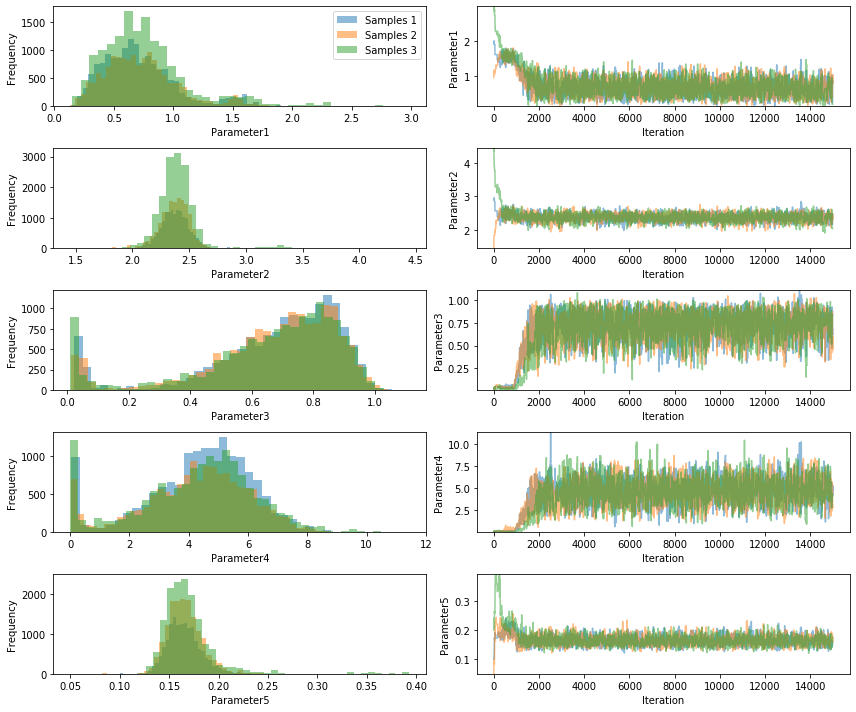

In [14]:
pints.plot.trace(samples)
plt.show()

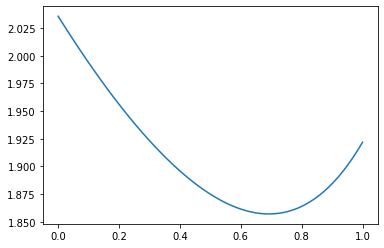

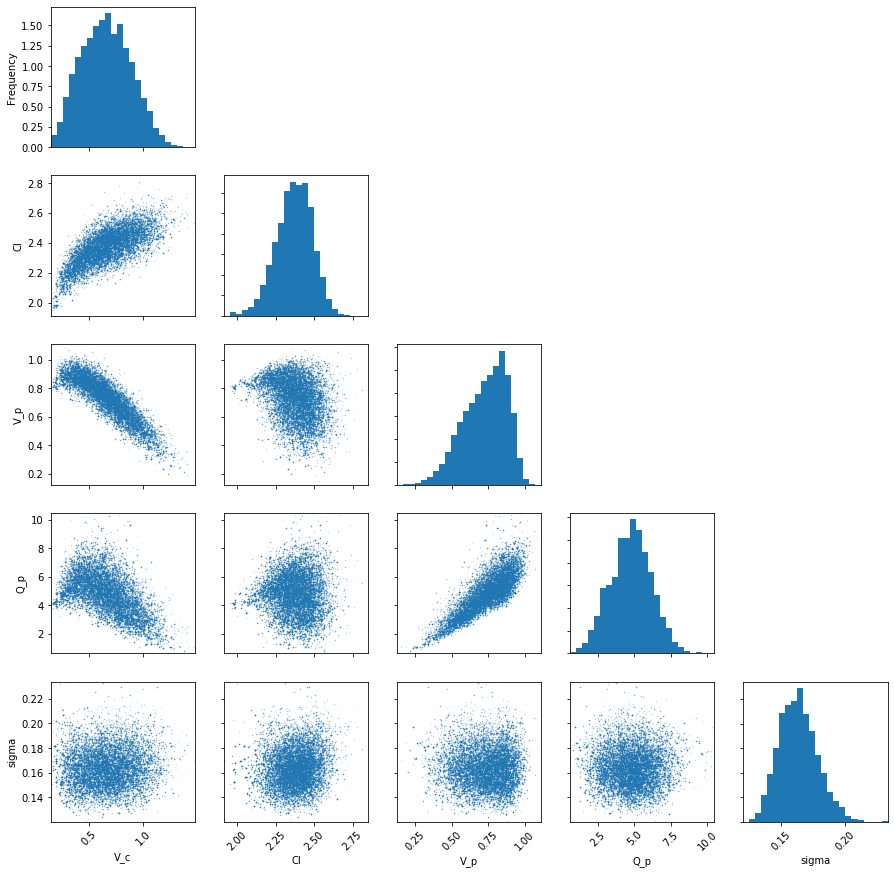

[0.65570594 2.36895561 0.72761048 4.78172055 0.16376779]
-0.048195214803401276
0.9999849760098235


In [32]:
num_points = 100
P_0 = np.asarray([Vol_C, Cl, Vol_perif, Q_perif])
P_1 = parameters1
errors = []
xs = np.linspace(0, 1, num_points)

for x in xs:
    point = x*P_0+(1-x)*P_1
    errors.append(error_measure(point))
    
plt.plot(xs, errors)
plt.show()

pints.plot.pairwise(np.vstack(samples[:,3000:]), parameter_names=['V_c', 'Cl', 'V_p', 'Q_p', 'sigma'])
plt.show()
mcmc_params = pints.MCMCSummary(samples[:,3000:], parameter_names=['V_c', 'Cl', 'V_p', 'Q_p', 'sigma']).mean()
print(mcmc_params)
print(error_measure(mcmc_params[:-1])-error_measure(actual_parameters))
print(pints.rhat(samples[:,3000:]))

In [25]:
# Lets Visualise using Plotly
import seaborn
import matplotlib.colors as clrs
from colorsys import rgb_to_hls

y_label = drug + " Concentration"
x_label = "Time"
df_graph = df.astype({'DOSE': 'str'})

fig = px.scatter(
    df_graph,
    title=drug + " Concentration Mean",
    x="TIME",
    y="OBS",
    color = "DOSE",
    width=800, 
    height=500
)

fig.update_xaxes(title_text=x_label)
fig.update_yaxes(title_text=y_label)
# fig.update_traces(mode='markers+lines')
# fig['data'][0]['showlegend']=True
# fig['data'][0]['name']='Observed Values'
for i,d in enumerate(dose):
    hex_color = px.colors.qualitative.Plotly[i]
    fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(mcmc_params[:-1], more_times)[:,i],
                        mode='lines',
                        name='Prediction',
                        legendgroup = d,
                        line={'dash': 'solid', 'color': hex_color}))
    
    rgb_color = clrs.ColorConverter.to_rgb(hex_color)
    lightness = min(1, rgb_to_hls(*rgb_color)[1] * 0.5)
    altered_color = clrs.to_hex(seaborn.set_hls_values(hex_color, l=lightness))
    
    fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(actual_parameters, more_times)[:,i],
                        mode='lines',
                        name='Actual',
                        legendgroup = d,
                        line={'dash': 'dash', 'color': altered_color}))

# fig.add_trace(go.Scatter(x=[0, point_2[0]], y=[y_0, point_2[1]],
#                     mode='lines',
#                     name='Y-axis intercept prediction'))

fig.update_layout(
    updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(
                    args=[{"yaxis.type": "linear"}],
                    label="Linear y-scale",
                    method="relayout"
                ),
                dict(
                    args=[{"yaxis.type": "log"}],
                    label="Log y-scale",
                    method="relayout"
                )
            ]),
            pad={"r": 0, "t": -10},
            showactive=True,
            x=1.0,
            xanchor="right",
            y=1.15,
            yanchor="top"
        ),
    ]
)
fig.show()

In [16]:
# Multiple Runs of the optimiser to visualise the stability

df_stability = pandas.DataFrame(columns=['Optimiser', 'Vol_C', 'Cl', 'Vol_perif', 'Q_perif', 'Error'])
num_runs = 10
optimisers = {'CMAES': pints.CMAES, 'PSO' : pints.PSO, 'XNES' : pints.XNES, 'SNES' : pints.SNES}
initial_parameters = np.concatenate((np.ones((num_runs,1))*Vol_C_approx, np.random.uniform(low=1E-2, high=1E2, size=(num_runs, num_comp*2 - 1))), axis=1)

for opt in optimisers:
    for i in range(num_runs):
        print('Performing '+opt+' optimisation, run number: '+str(i+1))
        optimisation = pints.OptimisationController(error_measure, initial_parameters[i], method=optimisers[opt], boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
        optimisation.set_log_to_screen(False)
        parameters, error = optimisation.run()
        df_stability = df_stability.append({'Optimiser': opt, 'Vol_C': parameters[0], 'Cl': parameters[1], 'Vol_perif': parameters[2], 'Q_perif': parameters[3], 'Error': error}, ignore_index=True)
        if opt == 'XNES':
            print('\t performing additional PSO')
            optimisation = pints.OptimisationController(error_measure, parameters, method=pints.PSO, boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
            optimisation.set_log_to_screen(False)
            parameters2, error2 = optimisation.run()
            df_stability = df_stability.append({'Optimiser': 'XNES-PSO', 'Vol_C': parameters2[0], 'Cl': parameters2[1], 'Vol_perif': parameters2[2], 'Q_perif': parameters2[3], 'Error': error2}, ignore_index=True)

            print('\t performing additional CMAES')
            optimisation = pints.OptimisationController(error_measure, parameters, method=pints.CMAES, boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
            optimisation.set_log_to_screen(False)
            parameters2, error2 = optimisation.run()
            df_stability = df_stability.append({'Optimiser': 'XNES-CMAES', 'Vol_C': parameters2[0], 'Cl': parameters2[1], 'Vol_perif': parameters2[2], 'Q_perif': parameters2[3], 'Error': error2}, ignore_index=True)

df_stability['Vol_C'] = df_stability['Vol_C'] - Vol_C
df_stability['Cl'] = df_stability['Cl'] - Cl
df_stability['Vol_perif'] = df_stability['Vol_perif'] - Vol_perif
df_stability['Q_perif'] = df_stability['Q_perif'] - Q_perif
df_stability['Error'] = df_stability['Error'] - error_measure([Vol_C, Cl, Vol_perif, Q_perif])

Performing CMAES optimisation, run number: 1
Performing CMAES optimisation, run number: 2
Performing CMAES optimisation, run number: 3
Performing CMAES optimisation, run number: 4
Performing CMAES optimisation, run number: 5
Performing CMAES optimisation, run number: 6
Performing CMAES optimisation, run number: 7
Performing CMAES optimisation, run number: 8
Performing CMAES optimisation, run number: 9
Performing CMAES optimisation, run number: 10
Performing PSO optimisation, run number: 1
Performing PSO optimisation, run number: 2


/home/rumneyr/anaconda3/lib/python3.7/site-packages/scipy/integrate/odepack.py:247: ODEintWarning:

Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.



Performing PSO optimisation, run number: 3
Performing PSO optimisation, run number: 4
Performing PSO optimisation, run number: 5
Performing PSO optimisation, run number: 6
Performing PSO optimisation, run number: 7
Performing PSO optimisation, run number: 8
Performing PSO optimisation, run number: 9
Performing PSO optimisation, run number: 10
Performing XNES optimisation, run number: 1
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 2
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 3
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 4
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 5
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 6
	 performing additional PSO
	 performing additional CMAES
Performing XNES optimisation, run number: 7

In [17]:
print(df_stability)

     Optimiser     Vol_C        Cl  Vol_perif    Q_perif     Error
0        CMAES -0.076514  0.085333   0.118466   1.112993 -0.234605
1        CMAES  0.278417  0.378533   0.157580  89.302197  0.118530
2        CMAES -0.226044  0.328577   0.595969  44.441295  0.118159
3        CMAES -0.050845  0.367818   0.471761  93.401835  0.118500
4        CMAES  0.091258  0.363112   0.324278  57.912496  0.118489
5        CMAES -0.031528  0.367341   0.452809  96.088778  0.118512
6        CMAES  0.193579  0.366221   0.226018  50.788355  0.118473
7        CMAES  0.758579  0.388329  -0.309798  68.393519  0.118534
8        CMAES -0.076514  0.085333   0.118466   1.112993 -0.234605
9        CMAES -0.076514  0.085334   0.118466   1.112994 -0.234605
10         PSO  0.936608  0.321238  97.076329  -2.256099  0.133648
11         PSO  0.832360  0.378582  -0.426972  -2.051993  0.047757
12         PSO  0.628423  0.359465  -0.270497  -1.108602 -0.034449
13         PSO  0.895001  0.390125  -0.443761  97.645602  0.11

In [18]:
param_to_view = 'Vol_C'
fig = px.box(df_stability, 
             x="Optimiser", 
             y=param_to_view,
             color="Optimiser",
             title="Distribution of Optimised values around true values for "+str(param_to_view),
             points="all")
fig.show()

param_to_view = 'Cl'
fig = px.box(df_stability, 
             x="Optimiser", 
             y=param_to_view,
             color="Optimiser",
             title="Distribution of Optimised values around true values for "+str(param_to_view),
             points="all")
fig.show()

param_to_view = 'Vol_perif'
fig = px.box(df_stability, 
             x="Optimiser", 
             y=param_to_view,
             color="Optimiser",
             title="Distribution of Optimised values around true values for "+str(param_to_view),
             points="all")
fig.show()

param_to_view = 'Q_perif'
fig = px.box(df_stability, 
             x="Optimiser", 
             y=param_to_view,
             color="Optimiser",
             title="Distribution of Optimised values around true values for "+str(param_to_view),
             points="all")
fig.show()

param_to_view = 'Error'
fig = px.box(df_stability, 
             x="Optimiser", 
             y=param_to_view,
             color="Optimiser",
             title="Distribution of Optimised errors",
             points="all")
fig.show()

In [19]:
import seaborn
import matplotlib.colors as clrs
from colorsys import rgb_to_hls

optimisers['XNES-PSO'] = pints.PSO
optimisers['XNES-CMAES'] = pints.CMAES
df_table = df_stability.groupby(["Optimiser"], as_index=False).agg(['mean','std', 'median', 'min', 'max'])
print(df_table)
for opt in optimisers:
    y_label = drug + " Concentration"
    x_label = "Time"
    df_graph = df.astype({'DOSE': 'str'})

    fig = px.scatter(
        df_graph,
        title=drug + " Concentration Mean",
        x="TIME",
        y="OBS",
        color = "DOSE",
        width=800, 
        height=500
    )

    fig.update_xaxes(title_text=x_label)
    fig.update_yaxes(title_text=y_label)
    
    index = df_stability.loc[(df_stability['Optimiser'] == opt)]['Error'].idxmin()
    params_to_graph = np.asarray([df_stability['Vol_C'][index], df_stability['Cl'][index], df_stability['Vol_perif'][index], df_stability['Q_perif'][index]])+np.asarray(actual_parameters)
    print(params_to_graph, actual_parameters)
    
    
    for i,d in enumerate(dose):
        hex_color = px.colors.qualitative.Plotly[i]
        fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(params_to_graph, more_times)[:,i],
                            mode='lines',
                            name='Prediction',
                            legendgroup = d,
                            line={'dash': 'solid', 'color': hex_color}))

        rgb_color = clrs.ColorConverter.to_rgb(hex_color)
        lightness = min(1, rgb_to_hls(*rgb_color)[1] * 0.5)
        altered_color = clrs.to_hex(seaborn.set_hls_values(hex_color, l=lightness))

        fig.add_trace(go.Scatter(x=more_times, y=PintsLinCompIV().simulate(actual_parameters, more_times)[:,i],
                            mode='lines',
                            name='Actual',
                            legendgroup = d,
                            line={'dash': 'dash', 'color': altered_color}))

    # fig.add_trace(go.Scatter(x=[0, point_2[0]], y=[y_0, point_2[1]],
    #                     mode='lines',
    #                     name='Y-axis intercept prediction'))

    fig.update_layout(
        updatemenus=[
            dict(
                type = "buttons",
                direction = "left",
                buttons=list([
                    dict(
                        args=[{"yaxis.type": "linear"}],
                        label="Linear y-scale",
                        method="relayout"
                    ),
                    dict(
                        args=[{"yaxis.type": "log"}],
                        label="Log y-scale",
                        method="relayout"
                    )
                ]),
                pad={"r": 0, "t": -10},
                showactive=True,
                x=1.0,
                xanchor="right",
                y=1.15,
                yanchor="top"
            ),
        ]
    )
    fig.show()

               Vol_C                                                Cl  \
                mean       std    median       min       max      mean   
Optimiser                                                                
CMAES       0.078387  0.280783 -0.041187 -0.226044  0.758579  0.281593   
PSO         0.673126  0.538703  0.863681 -0.826221  0.950169  0.369675   
SNES        0.767080  0.617487  0.959796 -0.989956  0.979469  0.410572   
XNES        0.775856  0.532251  0.952115 -0.736708  0.961061  0.399006   
XNES-CMAES  0.189330  0.345719  0.056091 -0.076513  0.950169  0.259268   
XNES-PSO    0.208165  0.427285  0.206810 -0.681532  0.852796  0.212910   

                                                    ...    Q_perif             \
                 std    median       min       max  ...       mean        std   
Optimiser                                           ...                         
CMAES       0.136278  0.364666  0.085333  0.388329  ...  50.366745  38.229541   
PSO      

[1.62842332 2.85946479 0.22950297 1.1913982 ] [1, 2.5, 0.5, 2.3]


[1.86282703 2.90153821 0.09711575 1.13123095] [1, 2.5, 0.5, 2.3]


[1.95506712 2.90691786 0.0100142  0.06469101] [1, 2.5, 0.5, 2.3]


[0.9005801  2.59446276 0.65273319 3.61276838] [1, 2.5, 0.5, 2.3]


[0.92348658 2.58533345 0.61846609 3.4129937 ] [1, 2.5, 0.5, 2.3]


### Real Data

Now we shall do the same as above but with Real data rather than simulated data. We do not know what the real parameters of the system are and so cannot truly know how accurately we are acquiring the correct results.

In [41]:
# Quick look at what the data contains
df = pandas.read_csv("0470-2008_2018-05-09.csv")
df = df.sort_values(['TIME', 'DOSE'], ascending=True)
group = df.groupby('DRUG')
df_view = group.apply(lambda x: x['DOSE'].unique())
df_view = df_view.apply(pandas.Series)
df_view = df_view.replace(np.nan, '', regex=True)
df_view.columns = ['Dose 1', "Dose 2", "Dose 3"]
print(df_view)

             Dose 1 Dose 2 Dose 3
DRUG                             
Controls        0.0              
Docetaxel       5.0     10     15
Irinotecan     34.0     68       
Topotecan       7.5     15       
Vinflunine     10.0     20       
Vinorelbine     5.0     10     20


In [42]:
from ipynb.fs.full.model_simulation import PK_iv_result # import the required model

# Options: change to one of the above drugs and corresponding doses
drug = 'Vinorelbine'
dose = df.loc[(df['YNAME'] == drug)]['DOSE'].unique()
num_comp = 2

# Refine the Data
df = df.astype({'ID': 'int64'})
df_drug = df.loc[(df['YNAME'] == drug)]
df_drug = df_drug[df_drug['DOSE'].isin(dose)]

# Find average values
df_OBS = df_drug.drop(df_drug[df_drug['OBS'] == '.'].index)[['TIME', 'DOSE', 'OBS']]
df_OBS = df_OBS.astype({'OBS': 'float64'})
df_OBS['OBS'] = df_OBS["OBS"]/1000 # Converting from ng/ml to mg/L
df_stats = df_OBS.groupby(["TIME", "DOSE"], as_index=False).filter(lambda x: len(x) > 0).groupby(["TIME", "DOSE"], as_index=False).agg({'OBS':['mean','std']})
df_stats.columns = ['TIME', "DOSE", 'mean', 'std']
df_stats = df_stats.sort_values(['DOSE', 'TIME'], ascending=True)
print(df_stats)

# Get actual dose amount
dose_amount = []
df_amt = df_drug.drop(df_drug[df_drug['AMT'] == '.'].index).astype({'AMT': 'float64'})
for d in dose:
    amt = df_amt.loc[(df_amt['DOSE'] == d)].mean()['AMT']
    dose_amount.append(amt)
print("Average dose amounts = " + str(dose_amount))

      TIME  DOSE      mean       std
0    0.083   5.0  0.514651  0.164551
3    0.250   5.0  0.180673  0.013776
6    0.666   5.0  0.113893  0.013253
9    2.830   5.0  0.058718  0.006137
12   8.660   5.0  0.036949  0.005439
14  18.330   5.0  0.021995  0.004173
1    0.083  10.0  0.837042  0.130230
4    0.250  10.0  0.323306  0.017301
7    0.666  10.0  0.236209  0.033233
10   2.830  10.0  0.113697  0.010441
13   8.660  10.0  0.068627  0.007223
15  20.000  10.0  0.041615  0.008612
2    0.083  20.0  3.136667  2.502636
5    0.500  20.0  0.675600  0.126283
8    1.666  20.0  0.313400  0.030328
11   5.000  20.0  0.239800  0.035675
16  24.500  20.0  0.140800  0.013755
17  30.000  20.0  0.144200  0.050987
Average dose amounts = [0.9764444444444444, 1.9918333333333333, 4.015333333333334]


In [43]:
# Create the model in PINTS (This is the same model as above but with the new dose and num_comp)
class PintsLinCompIV(pints.ForwardModel):
    def n_parameters(self):
        return num_comp*2
    def n_outputs(self):
        return len(dose_amount)
    def simulate(self, parameter, times):
        result = []
        for i,d in enumerate(dose_amount):
            obs_T = df_stats.loc[(df_stats['DOSE'] == dose[i])]['TIME'].to_numpy()
            obs_T = obs_T[times.astype(np.int64)]
            if obs_T[0] == 0:
                    result.append(PK_iv_result(d, num_comp, parameter, obs_T)[:,0])
            elif obs_T[0] > 0:  
                # If the times do not start at 0 then odeint will begin simulation at the first timepoint.
                # However our model assumes dosing happens at t=0 so we will need to add 0 to the times array and
                # then ignore the result at t=0.
                T_zero = np.concatenate((np.array([0]), obs_T))
                result.append(PK_iv_result(d, num_comp, parameter, T_zero)[1:,0])
        return np.asarray(result).T
        
class RatioError(pints.ProblemErrorMeasure):
    """
    Calculates a sum-of-squares error: ``f = sum( (log10(x[i]) -log10( y[i])**2 )``
    Extends :class:`ErrorMeasure`.
    Parameters
    ----------
    problem
        A :class:`pints.SingleOutputProblem` or
        :class:`pints.MultiOutputProblem`.
    """

    def __init__(self, problem, weights=None):
        super(RatioError, self).__init__(problem)

        if weights is None:
            weights = [1] * self._n_outputs
        elif self._n_outputs != len(weights):
            raise ValueError(
                'Number of weights must match number of problem outputs.')
        # Check weights
        self._weights = np.asarray([float(w) for w in weights])

    def __call__(self, x):
        return np.sum((np.sum((((self._problem.evaluate(x) - self._values) / self._values) ** 2),
                              axis=0) * self._weights),
                      axis=0)

In [44]:
# Before starting the optimisation we should estimate the parameter Vol_C. We can do this by drawing a line 
# through the first 2 points and seeing where it crosses the y-axis
i = 1
df_view = df_stats.loc[(df_stats['DOSE'] == dose[i])]
df_view = df_view.reset_index(drop=True)
print(df_view)
point_1 = (df_view['TIME'][0], df_view['mean'][0])
point_2 = (df_view['TIME'][1], df_view['mean'][1])
y_0 = point_1[1] - (point_1[1] - point_2[1])/(point_1[0] - point_2[0]) * point_1[0]
Vol_C_approx = y_0/dose_amount[i]
print(point_1, point_2, y_0, Vol_C_approx)

     TIME  DOSE      mean       std
0   0.083  10.0  0.837042  0.130230
1   0.250  10.0  0.323306  0.017301
2   0.666  10.0  0.236209  0.033233
3   2.830  10.0  0.113697  0.010441
4   8.660  10.0  0.068627  0.007223
5  20.000  10.0  0.041615  0.008612
(0.083, 0.8370423333333333) (0.25, 0.3233061666666666) 1.0923722844311379 0.5484255465305687


In [45]:
# Optimise the model with respect to the data
# time = df_stats['TIME'][0:int(len(df_stats)/len(dose_amount))].to_numpy()
# time = np.reshape(df_stats['TIME'].to_numpy(), (len(dose_amount), int(len(df_stats)/len(dose_amount)))).T
obs = np.reshape(df_stats['mean'].to_numpy(), (len(dose_amount), int(len(df_stats)/len(dose_amount)))).T
a_range = np.arange(0, int(len(df_stats)/len(dose_amount)))

problem = pints.MultiOutputProblem(PintsLinCompIV(), a_range, obs)
error_measure = RatioError(problem)  #for multiplicative noise
# error_measure = pints.SumOfSquaresError(problem)  # for additive noise
lower_bound = [0.01, 0.01, 0.01, 0.01]
upper_bound = [100, 100, 100, 100]

optimisation = pints.OptimisationController(error_measure, [Vol_C_approx, 1, 1, 1], method=pints.CMAES, boundaries=pints.RectangularBoundaries(lower_bound, upper_bound))
# optimisation.set_log_to_screen(False)
parameters, error = optimisation.run()


# Quick visualisation

time_span = df_stats["TIME"].max()
times = np.linspace(0,time_span,1000)

print('\t\t Run2')
print('Result:\t'+str(parameters))
print('Error: \t'+str(error))


# plt.figure()
# plt.plot(df_OBS['TIME'],  df_OBS['OBS'], '.', label='Observed values')
# plt.plot(times, PintsLinCompIV().simulate(parameters, times), '--', lw=2, label='Predicted Curve')
# plt.legend()
# plt.show()

Minimising error measure
Using Covariance Matrix Adaptation Evolution Strategy (CMA-ES)
Running in sequential mode.
Population size: 8
Iter. Eval. Best      Time m:s
0     8      4.677917   0:00.2
1     16     4.677917   0:00.4
2     24     4.677917   0:00.5
3     32     4.677917   0:00.7
20    168    2.932642   0:04.4
40    328    1.867171   0:07.1
60    488    1.646529   0:09.4
80    648    1.442031   0:13.0
100   808    1.44192    0:16.8
120   968    1.441919   0:20.7
140   1128   1.441919   0:24.5
160   1288   1.441919   0:28.2
180   1448   1.441919   0:32.0
200   1608   1.441919   0:35.8
220   1768   1.441919   0:39.6
240   1928   1.441919   0:43.6
260   2088   1.441919   0:48.3
280   2248   1.441919   0:52.6
300   2408   1.441919   0:56.7
320   2568   1.441919   1:00.7
331   2648   1.441919   1:03.1
Halting: No significant change for 200 iterations.
		 Run2
Result:	[ 1.93535195  0.66357418 11.41712029  6.15160705]
Error: 	1.441919438646738


In [46]:
# Visualisation using Plotly
import seaborn
import matplotlib.colors as clrs
from colorsys import rgb_to_hls

more_times = np.linspace(0, df_stats['TIME'].max(), 1000)

y_label = drug + " Concentration"
x_label = "Time"
df_graph = df_stats.astype({'DOSE': 'str'})

fig = px.scatter(
    df_graph,
    title=drug + " Concentration Mean",
    x="TIME",
    y="mean",
    color = "DOSE",
    width=800, 
    height=500
)

fig.update_xaxes(title_text=x_label)
fig.update_yaxes(title_text=y_label)
# fig.update_traces(mode='markers+lines')
# fig['data'][0]['showlegend']=True
# fig['data'][0]['name']='Observed Values'
for i,d in enumerate(dose_amount):
    hex_color = px.colors.qualitative.Plotly[i]
    fig.add_trace(go.Scatter(x=more_times, y=PK_iv_result(d, num_comp, parameters, more_times)[:,0],
                        mode='lines',
                        name='Prediction',
                        legendgroup = dose[i],
                        line={'dash': 'solid', 'color': hex_color}))

# fig.add_trace(go.Scatter(x=[0, point_2[0]], y=[y_0, point_2[1]],
#                     mode='lines',
#                     name='Y-axis intercept prediction'))

fig.update_layout(
    updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(
                    args=[{"yaxis.type": "linear"}],
                    label="Linear y-scale",
                    method="relayout"
                ),
                dict(
                    args=[{"yaxis.type": "log"}],
                    label="Log y-scale",
                    method="relayout"
                )
            ]),
            pad={"r": 0, "t": -10},
            showactive=True,
            x=1.0,
            xanchor="right",
            y=1.15,
            yanchor="top"
        ),
    ]
)
fig.show()

In [13]:
class SingleMultiplicativeGaussianLogLikelihood(pints.ProblemLogLikelihood):
    r"""
    Fixed Eta
    
    Calculates the log-likelihood for a time-series model assuming a single
    heteroscedastic Gaussian error of the model predictions
    :math:`f(t, \theta )`.
    This likelihood introduces two new scalar parameters, both of which are constant across all dimensions of
    the model output: an exponential power :math:`\eta` and a scale
    :math:`\sigma`.
    A heteroscedascic Gaussian noise model assumes that the observable
    :math:`X` is Gaussian distributed around the model predictions
    :math:`f(t, \theta )` with a standard deviation that scales with
    :math:`f(t, \theta )`
    .. math::
        X(t) = f(t, \theta) + \sigma f(t, \theta)^\eta v(t)
    where :math:`v(t)` is a standard i.i.d. Gaussian random variable
    .. math::
        v(t) \sim \mathcal{N}(0, 1).
    This model leads to a log likelihood of the model parameters of
    .. math::
        \log{L(\theta, \eta , \sigma | X^{\text{obs}})} =
            -\frac{n_t}{2} \log{2 \pi}
            -\sum_{i=1}^{n_t}{\log{f(t_i, \theta)^\eta \sigma}}
            -\frac{1}{2}\sum_{i=1}^{n_t}\left(
                \frac{X^{\text{obs}}_{i} - f(t_i, \theta)}
                {f(t_i, \theta)^\eta \sigma}\right) ^2,
    where :math:`n_t` is the number of time points in the series, and
    :math:`X^{\text{obs}}_{i}` the measurement at time :math:`t_i`.
    For a system with :math:`n_o` outputs, this becomes
    .. math::
        \log{L(\theta, \eta , \sigma | X^{\text{obs}})} =
            -\frac{n_t n_o}{2} \log{2 \pi}
            -\sum ^{n_o}_{j=1}\sum_{i=1}^{n_t}{\log{f_j(t_i, \theta)^\eta
            \sigma}}
            -\frac{1}{2}\sum ^{n_o}_{j=1}\sum_{i=1}^{n_t}\left(
                \frac{X^{\text{obs}}_{ij} - f_j(t_i, \theta)}
                {f_j(t_i, \theta)^\eta \sigma}\right) ^2,
    where :math:`n_o` is the number of outputs of the model, and
    :math:`X^{\text{obs}}_{ij}` the measurement of output :math:`j` at
    time point :math:`t_i`.
    Extends :class:`ProblemLogLikelihood`.
    Parameters
    ----------
    ``problem``
        A :class:`SingleOutputProblem` or :class:`MultiOutputProblem`. For both
        single-output problems and multi-output problems, two parameters are added (:math:`\eta`,
        :math:`\sigma`).
    """

    def __init__(self, problem):
        super(SingleMultiplicativeGaussianLogLikelihood, self).__init__(problem)

        # Get number of times and number of outputs
        self._nt = len(self._times)
        no = problem.n_outputs()
        self._np = 1  # 1 parameters added

        # Add parameters to problem
        self._n_parameters = problem.n_parameters() + self._np

        # Pre-calculate the constant part of the likelihood
        self._logn = 0.5 * self._nt * no * np.log(2 * np.pi)

    def __call__(self, x):
        # Get noise parameters
        noise_parameters = x[-self._np:]
        eta = 1 # np.asarray(noise_parameters[0])
        sigma = np.asarray(noise_parameters[0])

        # Evaluate function (n_times, n_output)
        function_values = self._problem.evaluate(x[:-self._np])

        # Compute likelihood
        log_likelihood = \
            -self._logn - np.sum(
                np.sum(np.log(function_values**eta * sigma), axis=0)
                + 0.5 / sigma**2 * np.sum(
                    (self._values - function_values)**2
                    / function_values ** (2 * eta), axis=0))

        return log_likelihood
    
class SingleGaussianLogLikelihood(pints.ProblemLogLikelihood):
    r"""
    Calculates a log-likelihood assuming independent Gaussian noise at each
    time point, and adds a parameter representing the standard deviation
    (sigma) of the noise on each output.
    For a noise level of ``sigma``, the likelihood becomes:
    .. math::
        L(\theta, \sigma|\boldsymbol{x})
            = p(\boldsymbol{x} | \theta, \sigma)
            = \prod_{j=1}^{n_t} \frac{1}{\sqrt{2\pi\sigma^2}}\exp\left(
                -\frac{(x_j - f_j(\theta))^2}{2\sigma^2}\right)
    leading to a log likelihood of:
    .. math::
        \log{L(\theta, \sigma|\boldsymbol{x})} =
            -\frac{n_t}{2} \log{2\pi}
            -n_t \log{\sigma}
            -\frac{1}{2\sigma^2}\sum_{j=1}^{n_t}{(x_j - f_j(\theta))^2}
    where ``n_t`` is the number of time points in the series, ``x_j`` is the
    sampled data at time ``j`` and ``f_j`` is the simulated data at time ``j``.
    For a system with ``n_o`` outputs, this becomes
    .. math::
        \log{L(\theta, \sigma|\boldsymbol{x})} =
            -\frac{n_t n_o}{2}\log{2\pi}
            -\sum_{i=1}^{n_o}{ {n_t}\log{\sigma_i} }
            -\sum_{i=1}^{n_o}{\left[
                \frac{1}{2\sigma_i^2}\sum_{j=1}^{n_t}{(x_j - f_j(\theta))^2}
             \right]}
    Extends :class:`ProblemLogLikelihood`.
    Parameters
    ----------
    problem
        A :class:`SingleOutputProblem` or :class:`MultiOutputProblem`. For a
        single-output problem a single parameter is added, for a multi-output
        problem ``n_outputs`` parameters are added.
    """

    def __init__(self, problem):
        super(SingleGaussianLogLikelihood, self).__init__(problem)

        # Get number of times, number of outputs
        self._nt = len(self._times)
        self._no = problem.n_outputs()

        # Add parameters to problem
        self._n_parameters = problem.n_parameters() + 1

        # Pre-calculate parts
        self._logn = 0.5 * self._nt * np.log(2 * np.pi)

    def __call__(self, x):
        sigma = np.asarray(x[-1:])
        error = self._values - self._problem.evaluate(x[:-1])
        return np.sum(- self._logn - self._nt * np.log(sigma)
                      - np.sum(error**2, axis=0) / (2 * sigma**2))

    def evaluateS1(self, x):
        """ See :meth:`LogPDF.evaluateS1()`. """
        sigma = np.asarray(x[-1:])

        # Evaluate, and get residuals
        y, dy = self._problem.evaluateS1(x[:-1])

        # Reshape dy, in case we're working with a single-output problem
        dy = dy.reshape(self._nt, self._no, self._n_parameters - self._no)

        # Note: Must be (data - simulation), sign now matters!
        r = self._values - y

        # Calculate log-likelihood
        L = self.__call__(x)

        # Calculate derivatives in the model parameters
        dL = np.sum(
            (sigma**(-2.0) * np.sum((r.T * dy.T).T, axis=0).T).T, axis=0)

        # Calculate derivative wrt sigma
        dsigma = -self._nt / sigma + sigma**(-3.0) * np.sum(r**2, axis=0)
        dL = np.concatenate((dL, np.array(list(dsigma))))

        # Return
        return L, dL


In [14]:
# A look at the distribution of the parameters
log_likelihood = SingleGaussianLogLikelihood(problem) # For additive noise
# log_likelihood = SingleMultiplicativeGaussianLogLikelihood(problem) # for multiplicative nois

log_prior = pints.UniformLogPrior(lower_bound+[0.001], upper_bound+[100])
log_posterior = pints.LogPosterior(log_likelihood, log_prior)

startpoints = [np.concatenate((np.asarray(parameters), np.asarray([0.1]))),np.concatenate((np.asarray(parameters)*0.5, np.asarray([0.1]))), np.concatenate((np.asarray(parameters)*1.5, np.asarray([0.1])))]
mcmc = pints.MCMCController(log_posterior, 3, startpoints, method=pints.HaarioBardenetACMC)
mcmc.set_max_iterations(15000)
# mcmc.set_log_to_screen(False)
samples = mcmc.run()

Using Haario-Bardenet adaptive covariance MCMC
Generating 3 chains.
Running in sequential mode.
Iter. Eval. Accept.   Accept.   Accept.   Time m:s
0     3      0         0         0          0:00.1
1     6      0         0         0.5        0:00.3
2     9      0.333     0.333     0.667      0:00.4
3     12     0.25      0.25      0.5        0:00.5
20    63     0.19      0.0952    0.19       0:02.0
40    123    0.122     0.0488    0.244      0:03.9
60    183    0.18      0.0492    0.295082   0:05.7
80    243    0.16      0.037     0.259      0:07.5
100   303    0.149     0.0297    0.228      0:09.2
120   363    0.124     0.0248    0.198      0:10.9
140   423    0.113     0.0284    0.184      0:13.1
160   483    0.106     0.0248    0.18       0:15.3
180   543    0.11      0.0276    0.177      0:17.5
Initial phase completed.
200   603    0.129     0.039801  0.164      0:19.5
220   663    0.167     0.0769    0.199095   0:21.6
240   723    0.203     0.0996    0.216      0:24.1
260   783   

3100  9303   0.211     0.199     0.206385   2:20.7
3120  9363   0.211     0.199     0.205      2:21.3
3140  9423   0.211     0.199     0.205      2:21.8
3160  9483   0.212     0.199304  0.203733   2:22.3
3180  9543   0.212     0.2       0.203      2:22.8
3200  9603   0.212     0.199     0.203      2:23.3
3220  9663   0.212     0.201     0.204      2:23.9
3240  9723   0.213     0.202     0.204      2:24.5
3260  9783   0.213     0.203     0.203      2:25.0
3280  9843   0.213     0.203     0.203      2:25.5
3300  9903   0.213     0.20206   0.203      2:26.0
3320  9963   0.212     0.202     0.202      2:26.5
3340  10023  0.211314  0.203     0.203      2:27.1
3360  10083  0.212     0.203     0.203      2:27.7
3380  10143  0.212     0.202307  0.203      2:28.4
3400  10203  0.212     0.202     0.203      2:28.9
3420  10263  0.213     0.203     0.203      2:29.5
3440  10323  0.212     0.202848  0.202      2:30.0
3460  10383  0.211     0.203     0.203      2:30.6
3480  10443  0.211     0.202528

6320  18963  0.215     0.215     0.22       3:50.4
6340  19023  0.215     0.215     0.22       3:50.9
6360  19083  0.215     0.215     0.219934   3:51.4
6380  19143  0.215     0.21517   0.22       3:52.0
6400  19203  0.215     0.215     0.22       3:52.5
6420  19263  0.215     0.216     0.22       3:53.0
6440  19323  0.215     0.215     0.22       3:53.5
6460  19383  0.215     0.215     0.22       3:54.1
6480  19443  0.216     0.214936  0.22       3:54.7
6500  19503  0.216     0.215     0.22       3:55.3
6520  19563  0.216     0.215     0.22       3:55.9
6540  19623  0.216     0.215     0.22       3:56.4
6560  19683  0.216     0.215     0.22       3:56.8
6580  19743  0.216     0.215     0.22       3:57.3
6600  19803  0.215     0.215     0.22       3:57.9
6620  19863  0.215     0.215     0.22       3:58.5
6640  19923  0.215329  0.215329  0.22       3:59.1
6660  19983  0.216     0.215     0.22       3:59.7
6680  20043  0.215836  0.215     0.22       4:00.3
6700  20103  0.216     0.215   

9540  28623  0.221     0.219     0.217      5:20.9
9560  28683  0.221     0.219     0.217      5:21.3
9580  28743  0.221     0.219     0.217      5:22.0
9600  28803  0.221     0.219     0.217      5:22.6
9620  28863  0.222     0.219     0.216      5:23.2
9640  28923  0.222     0.219     0.216      5:23.8
9660  28983  0.222     0.219     0.217      5:24.3
9680  29043  0.222     0.219     0.217      5:24.9
9700  29103  0.222     0.219     0.217      5:25.6
9720  29163  0.222     0.219     0.217      5:26.2
9740  29223  0.222     0.219074  0.217      5:26.7
9760  29283  0.222     0.219     0.217      5:27.4
9780  29343  0.222     0.219     0.217      5:28.0
9800  29403  0.222     0.219     0.217      5:28.6
9820  29463  0.222     0.218     0.217      5:29.1
9840  29523  0.22264   0.218     0.218      5:29.7
9860  29583  0.223     0.219     0.217      5:30.2
9880  29643  0.223     0.219     0.217      5:30.7
9900  29703  0.223     0.219     0.217      5:31.3
9920  29763  0.223     0.219   

12760 38283  0.226     0.223     0.221      6:53.1
12780 38343  0.226     0.223     0.220953   6:53.6
12800 38403  0.225     0.222717  0.221      6:54.1
12820 38463  0.225     0.223     0.221      6:54.5
12840 38523  0.225     0.223     0.221      6:54.9
12860 38583  0.225     0.222     0.221      6:55.5
12880 38643  0.225     0.222     0.222      6:56.1
12900 38703  0.225     0.222     0.222      6:56.7
12920 38763  0.225     0.222     0.222      6:57.2
12940 38823  0.225     0.222     0.222      6:57.8
12960 38883  0.225     0.222     0.221      6:58.3
12980 38943  0.225     0.222     0.221      6:58.9
13000 39003  0.225     0.222     0.221      6:59.4
13020 39063  0.225     0.222     0.221      7:00.0
13040 39123  0.226     0.222     0.221      7:00.7
13060 39183  0.226     0.222     0.221      7:01.4
13080 39243  0.226     0.222     0.221      7:02.0
13100 39303  0.226     0.223     0.221      7:02.5
13120 39363  0.226     0.223     0.222      7:03.3
13140 39423  0.226     0.222738

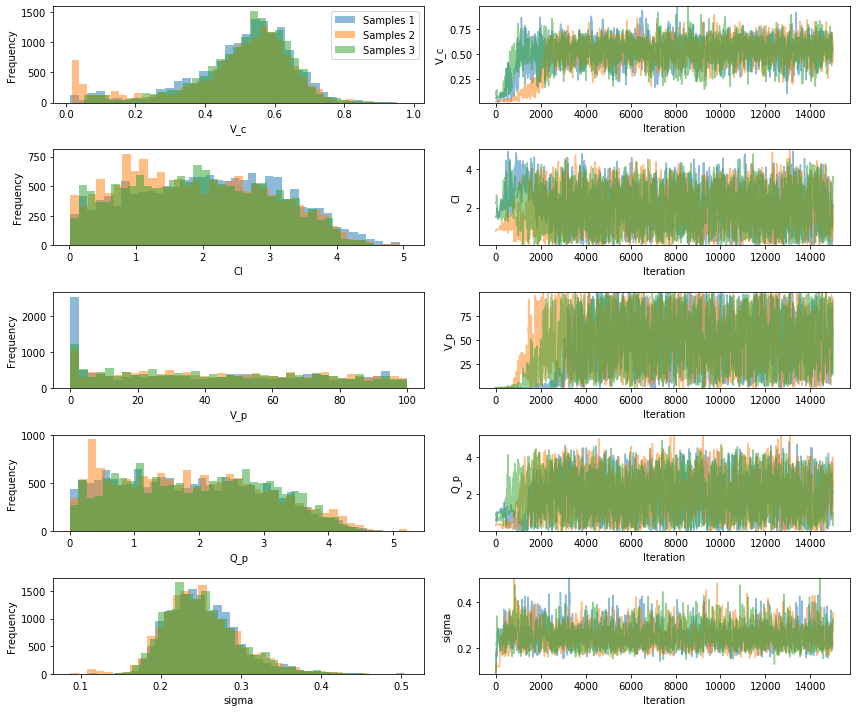

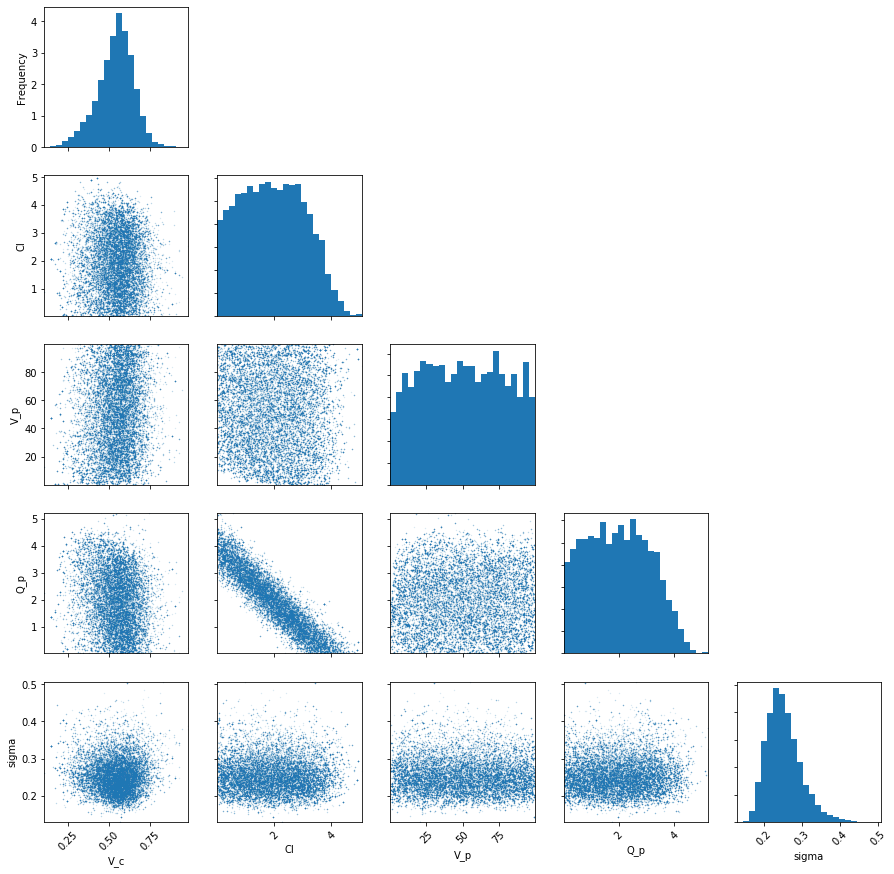

[ 0.53885748  1.95928792 50.35218508  1.98221146  0.25204962]
0.90767809100799
0.9999790741697963


In [15]:
pints.plot.trace(samples, parameter_names=['V_c', 'Cl', 'V_p', 'Q_p', 'sigma'])
plt.show()
pints.plot.pairwise(np.vstack(samples[:,3000:]), parameter_names=['V_c', 'Cl', 'V_p', 'Q_p', 'sigma'])
plt.show()
mcmc_params = pints.MCMCSummary(samples[:,3000:], parameter_names=['V_c', 'Cl', 'V_p', 'Q_p', 'sigma']).mean()
print(mcmc_params)
print(error_measure(mcmc_params[:-1]))
print(pints.rhat(samples[:,3000:]))

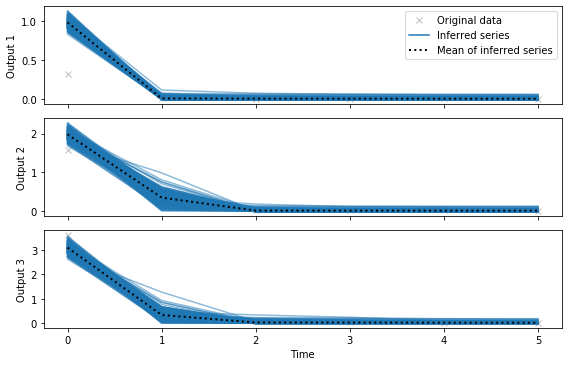

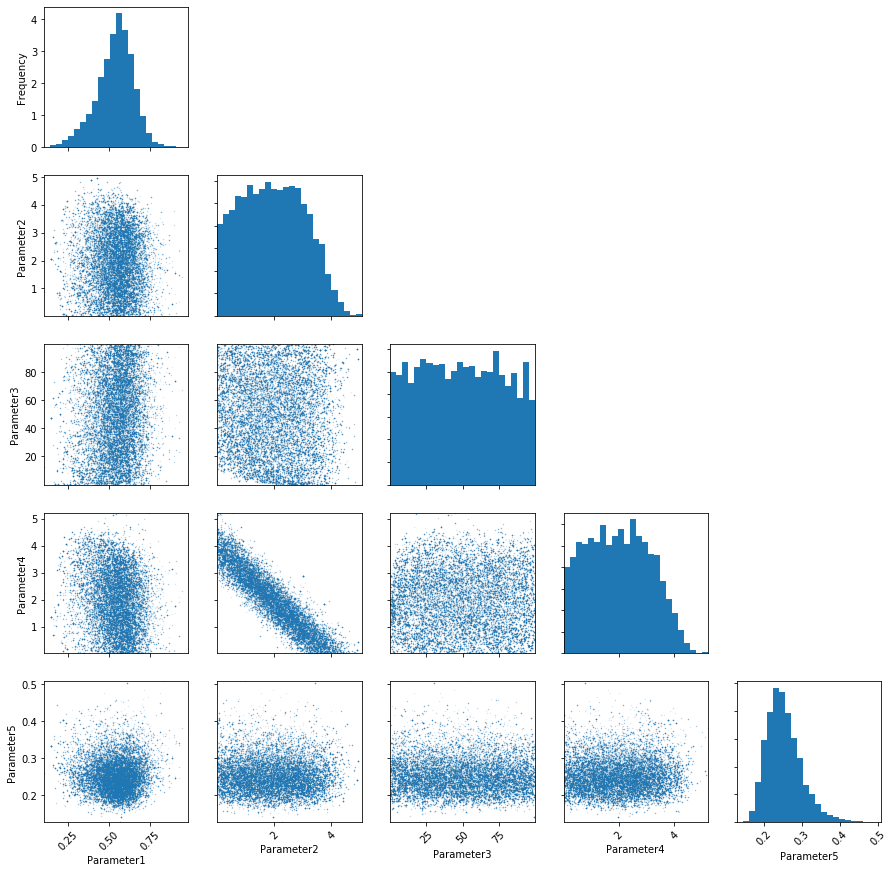

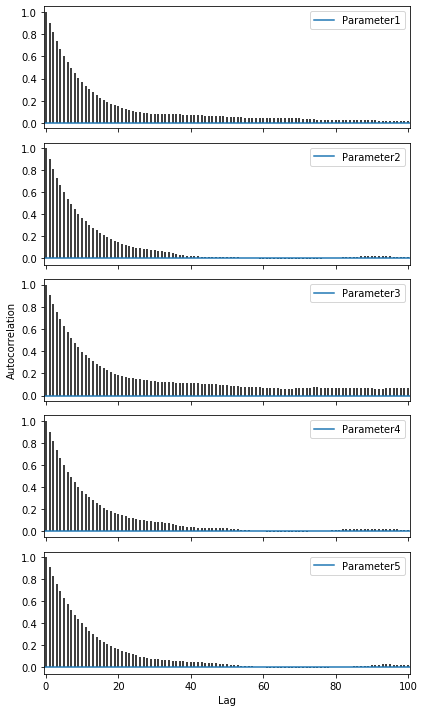

In [16]:
# Visualisation using Plotly
import seaborn
import matplotlib.colors as clrs
from colorsys import rgb_to_hls

more_times = np.linspace(0, df_stats['TIME'].max(), 1000)

y_label = drug + " Concentration"
x_label = "Time"
df_graph = df_stats.astype({'DOSE': 'str'})

fig = px.scatter(
    df_graph,
    title=drug + " Concentration Mean",
    x="TIME",
    y="mean",
    color = "DOSE",
    width=800, 
    height=500
)

fig.update_xaxes(title_text=x_label)
fig.update_yaxes(title_text=y_label)
# fig.update_traces(mode='markers+lines')
# fig['data'][0]['showlegend']=True
# fig['data'][0]['name']='Observed Values'
for i,d in enumerate(dose_amount):
    hex_color = px.colors.qualitative.Plotly[i]
    rgb_color = clrs.ColorConverter.to_rgb(hex_color)
    rgba_color = 'rgba' + str((rgb_color[0], rgb_color[1], rgb_color[2], 0.25))
    lightness = min(1, rgb_to_hls(*rgb_color)[1] * 0.5)
    altered_color = clrs.to_hex(seaborn.set_hls_values(hex_color, l=lightness))
    
    for param_sample in np.vstack(samples[:,3000::500]):
        fig.add_trace(go.Scatter(x=more_times, y=PK_iv_result(d, num_comp, param_sample[:-1], more_times)[:,0],
                            mode='lines',
                            name='Inferred Series',
                            legendgroup = dose[i],
                            line={'dash': 'solid', 'color': rgba_color},
                            showlegend=False))
    
    fig.add_trace(go.Scatter(x=more_times, y=PK_iv_result(d, num_comp, mcmc_params[:-1], more_times)[:,0],
                        mode='lines',
                        name='Mean of inferred series',
                        legendgroup = dose[i],
                        line={'dash': 'dash', 'color': altered_color}))
    

fig.update_layout(
    updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(
                    args=[{"yaxis.type": "linear"}],
                    label="Linear y-scale",
                    method="relayout"
                ),
                dict(
                    args=[{"yaxis.type": "log"}],
                    label="Log y-scale",
                    method="relayout"
                )
            ]),
            pad={"r": 0, "t": -10},
            showactive=True,
            x=1.0,
            xanchor="right",
            y=1.15,
            yanchor="top"
        ),
    ]
)
fig.show()

pints.plot.series(np.vstack(samples[:,2000:]), problem)
plt.show()
pints.plot.pairwise(np.vstack(samples[:,2000:]))
plt.show()
pints.plot.autocorrelation(np.vstack(samples[:,2000:]))
plt.show()

In [17]:
error_score = RatioError(problem)
print(error_score(parameters))

15.465893335683813


# PD

In [1]:
import numpy as np
# import math
# import matplotlib.pyplot as plt
# import scipy
# from scipy import optimize, integrate
import pints
# import pints.plot
import pandas
# import plotly.express as px
# import plotly.graph_objects as go
# import nbformat

# Get our Log-likelihoods:
from ipynb.fs.full.model_simulation import GaussianLogLikelihood
from ipynb.fs.full.model_simulation import MultiplicativeGaussianLogLikelihood
from ipynb.fs.full.model_simulation import ConstantAndMultiplicativeGaussianLogLikelihood
from ipynb.fs.full.model_simulation import ConstantAndMultiplicativeGaussianLogLikelihoodFixEta

In [2]:
data_type = 'real'
model_type = 'add'
drug = 'Docetaxel'
observation = 'Platelets '
dose = 10
num_comp = 2

# Load data
df = pandas.read_csv("0470-2008_2018-05-09.csv")
df = df.sort_values(['DOSE', 'TIME'], ascending=True)
df = df.astype({'ID': 'int64'})
df_drug = df.loc[(df['DOSE'] == dose) & (df['DRUG'] == drug)] #
df_OBS = df_drug.loc[(df_drug['YNAME'] == observation)]
df_OBS = df_OBS.drop(df_OBS[df_OBS['OBS'] == '.'].index)[['TIME', 'DOSE', 'OBS']]
df_OBS = df_OBS.astype({'OBS': 'float64'})
df_stats = df_OBS[['TIME', 'DOSE', 'OBS']]
df_stats = df_stats.astype({'OBS': 'float64'})
df_stats = df_stats.groupby(["TIME", "DOSE"], as_index=False).filter(lambda x: len(x) > 1).groupby(["TIME", "DOSE"], as_index=False).agg({'OBS':['mean','std']})
df_stats.columns = ['TIME', "DOSE", 'mean', 'std']

# Load samples
samples = np.load("./Data_and_parameters/pd_"+data_type+"_mcmc_"+model_type+"_params_dose_"+str(dose)+".npy")
print(samples.shape)

(3, 21000, 5)


In [3]:
from ipynb.fs.full.model_simulation import PintsPDFriberg # import the pints model

# Create the model in PINTS
PK_params=np.load('PK_parameters_real_'+drug+str(dose)+'.npy')
start_time = df_OBS['TIME'].min()
print(start_time)

pints_model_real = PintsPDFriberg(PK_params, dose, num_comp=num_comp, start_time=start_time)
problem = pints.SingleOutputProblem(pints_model_real, np.asarray(df_stats['TIME'])-start_time, df_stats['mean'])

-48.0


In [4]:
# Recreate
# parameters = np.load("./Data_and_parameters/pd_"+data_type+"_opt_"+model_type+"_params_dose_"+str(dose)+".npy")

log_likelihood = GaussianLogLikelihood(problem)
test_likelihood = pints.GaussianLogLikelihood(problem)
num_iterations = (pints_model_real.n_parameters()+3)*3000

# print(parameters)

In [5]:
pointwise = []
sum_likelihoods = []

no_samples = samples.shape[1]
for chain_no, chain in enumerate(samples):
    proportion_check = 0
    for j, sample_parameters in enumerate(chain):
        single_pointwise = log_likelihood.create_pointwise_loglikelihoods(sample_parameters)
        pointwise.append(single_pointwise)
        # test_parameters = np.append(sample_parameters, 1)
        test = test_likelihood.__call__(sample_parameters)
        sum_likelihoods.append(test)
        proportion = (j+1)/no_samples
        if proportion > proportion_check:
            print("chain "+str(chain_no+1)+"\t\t" +str(proportion_check*100)+"%")
            if proportion_check < 0.1:
                proportion_check += 0.01
            else:
                proportion_check += 0.1
pointwise = np.asarray(pointwise)

chain 1		0%
chain 1		1.0%
chain 1		2.0%
chain 1		3.0%
chain 1		4.0%
chain 1		5.0%
chain 1		6.000000000000001%
chain 1		7.000000000000001%
chain 1		8.0%
chain 1		9.0%
chain 1		10.0%
chain 1		10.999999999999998%
chain 1		21.0%
chain 1		31.0%
chain 1		41.0%
chain 1		51.0%
chain 1		61.0%
chain 1		71.0%
chain 1		81.0%
chain 1		90.99999999999999%
chain 2		0%
chain 2		1.0%
chain 2		2.0%
chain 2		3.0%
chain 2		4.0%
chain 2		5.0%
chain 2		6.000000000000001%
chain 2		7.000000000000001%
chain 2		8.0%
chain 2		9.0%
chain 2		10.0%
chain 2		10.999999999999998%
chain 2		21.0%
chain 2		31.0%
chain 2		41.0%
chain 2		51.0%
chain 2		61.0%
chain 2		71.0%
chain 2		81.0%
chain 2		90.99999999999999%
chain 3		0%
chain 3		1.0%
chain 3		2.0%
chain 3		3.0%
chain 3		4.0%
chain 3		5.0%
chain 3		6.000000000000001%
chain 3		7.000000000000001%
chain 3		8.0%
chain 3		9.0%
chain 3		10.0%
chain 3		10.999999999999998%
chain 3		21.0%
chain 3		31.0%
chain 3		41.0%
chain 3		51.0%
chain 3		61.0%
chain 3		71.0%
chain 3		81.0%

In [27]:
np.save("./Data_and_parameters/pd_"+data_type+"_mcmc_"+model_type+"_pointwiseLogLikelihoods_dose_"+str(dose)+".npy", pointwise)